In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

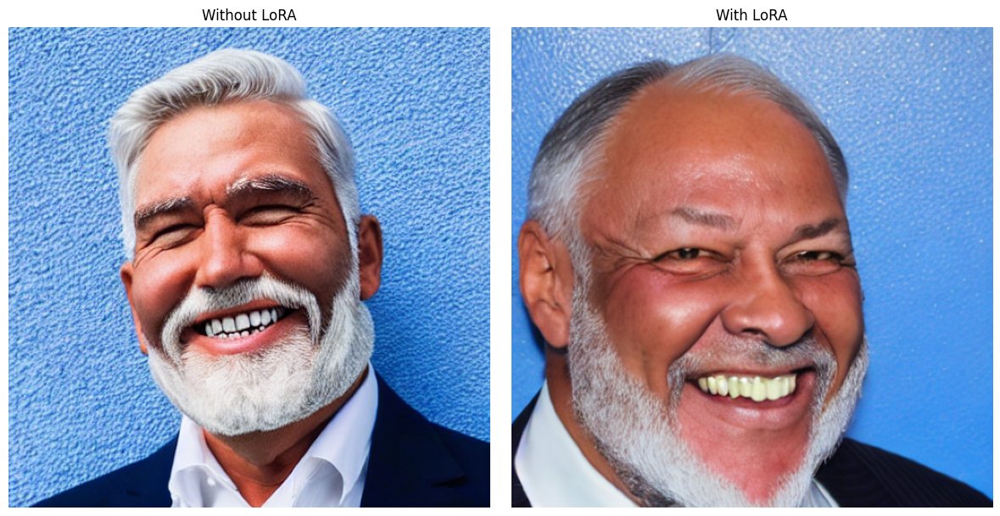

In [9]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "A full size image for an older man with a white beard and white teeth, wearing a suit. He appears to be happy, possibly due to a recent event or news. The man is standing in front of a blue background, which could be a wall or a backdrop."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

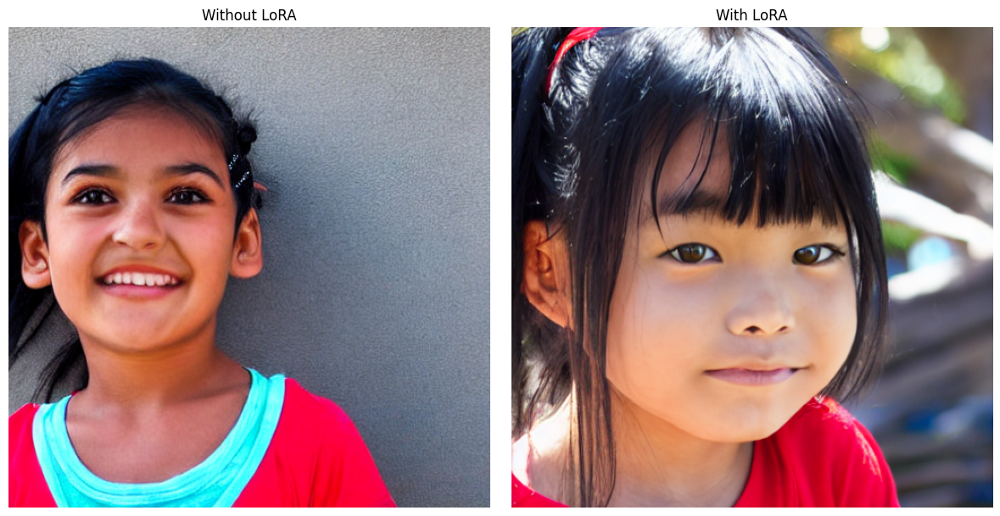

In [10]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young girl with black hair and black eyes, wearing a red shirt. She is looking at the camera with a happines expression.  The background of the image is blurry, focusing on the girl ."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

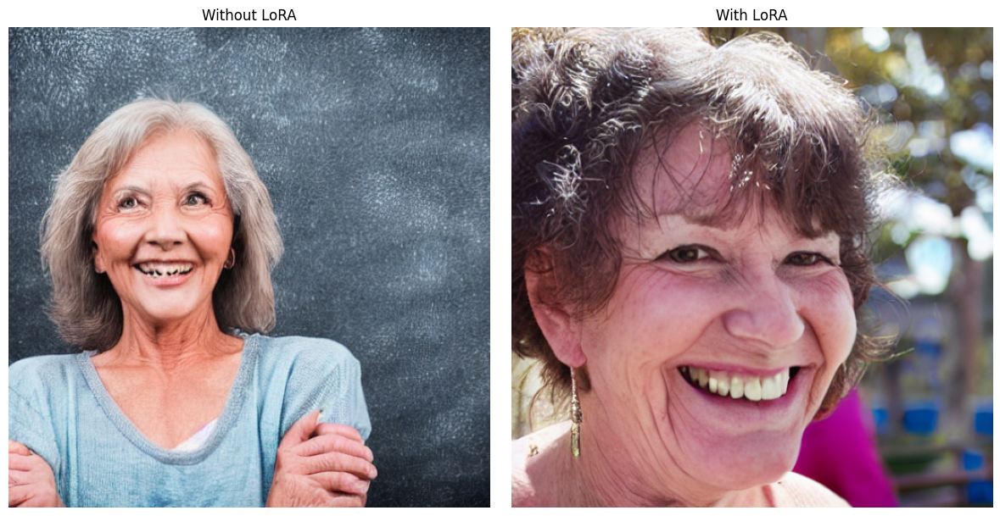

In [11]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a midage women she is happy and looking to camera and background is blured ."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

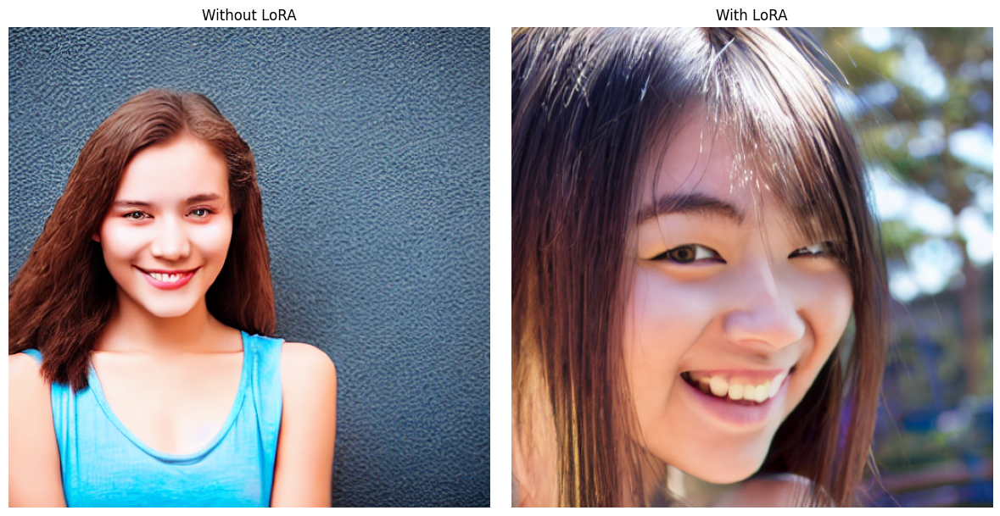

In [12]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young women she is happy and looking to camera and background is blured ."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

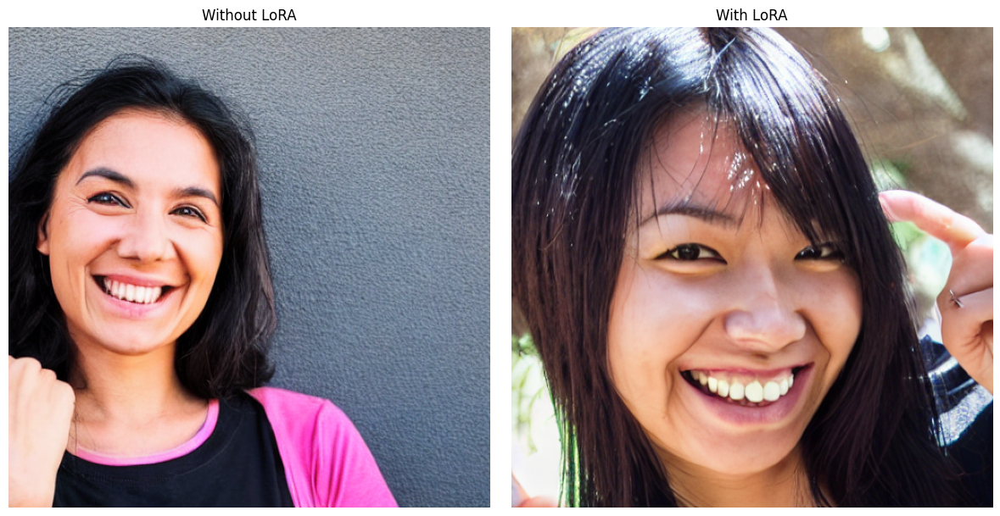

In [15]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a smiling woman with dark hair and a pinkish skin tone. She is wearing a black shirt and has a nose piercing. The woman appears to be happy and is posing for a picture. The background of the image is blurry, which emphasizes the focus on the woman's face and expression."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

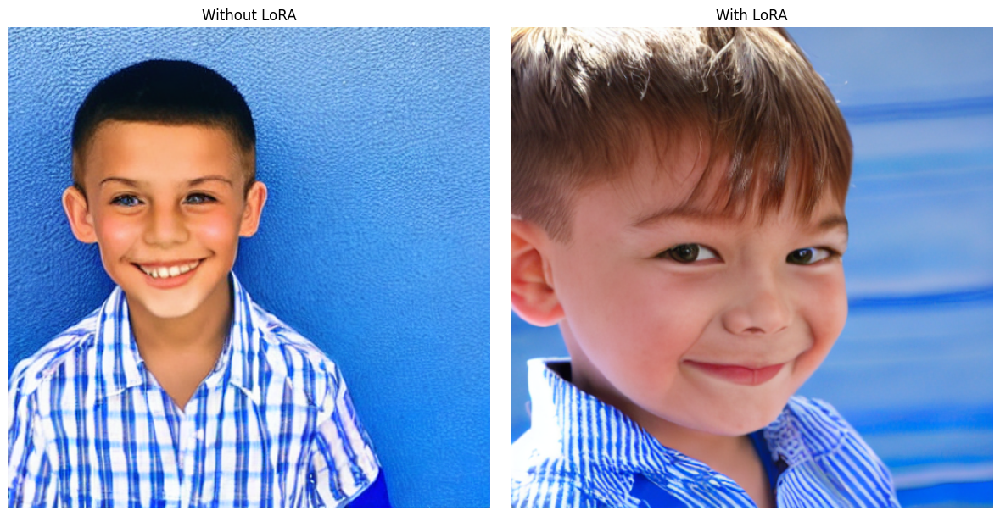

In [16]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young boy with short hair, wearing a blue and white shirt. He is looking at the camera with a smile on his face, indicating that he is happy or content. The boy is standing in front of a red background, which adds a pop of color to the scene."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

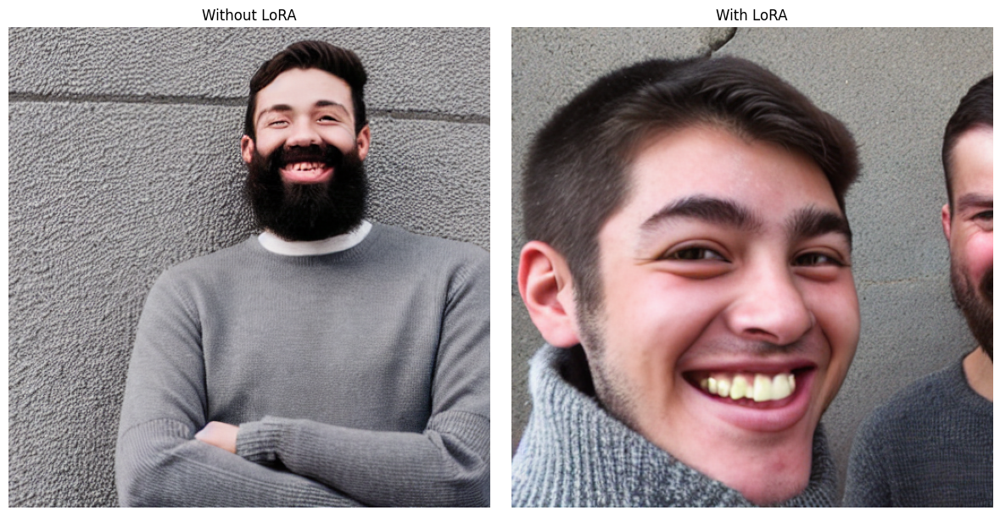

In [17]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young man with a beard , smiling brightly. He is wearing a gray sweater and appears to be in a happy and cheerful mood. The man is standing in front of a wall, and there is another person partially visible in the background."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

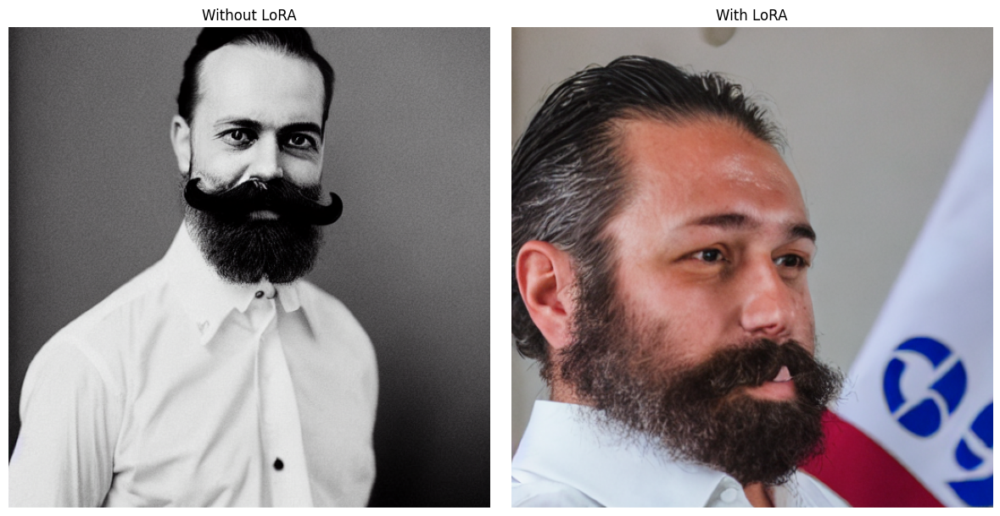

In [21]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a man with a beard and mustache, wearing a white shirt. He appears to be in a professional setting, as there is a flag in the background. The man is looking directly at the camera, possibly posing for a portrait or a formal photograph."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

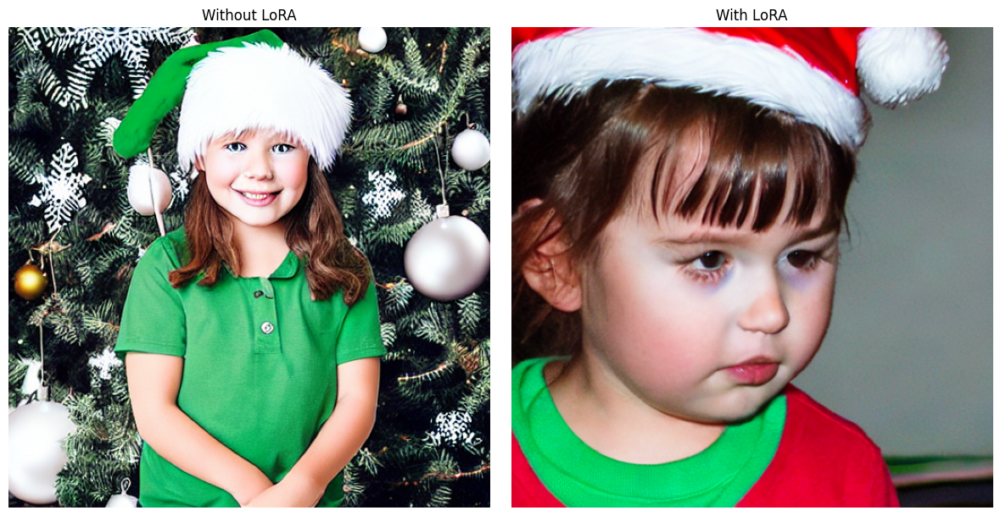

In [14]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young child, likely a little girl, wearing a green shirt and a Santa hat.  appears to be looking upwards. The child is wearing a green shirt, and the Santa hat is placed on her head. The background of the image is not clearly visible, but it seems to be a casual, playful setting."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['expression .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['expression .']


  0%|          | 0/50 [00:00<?, ?it/s]

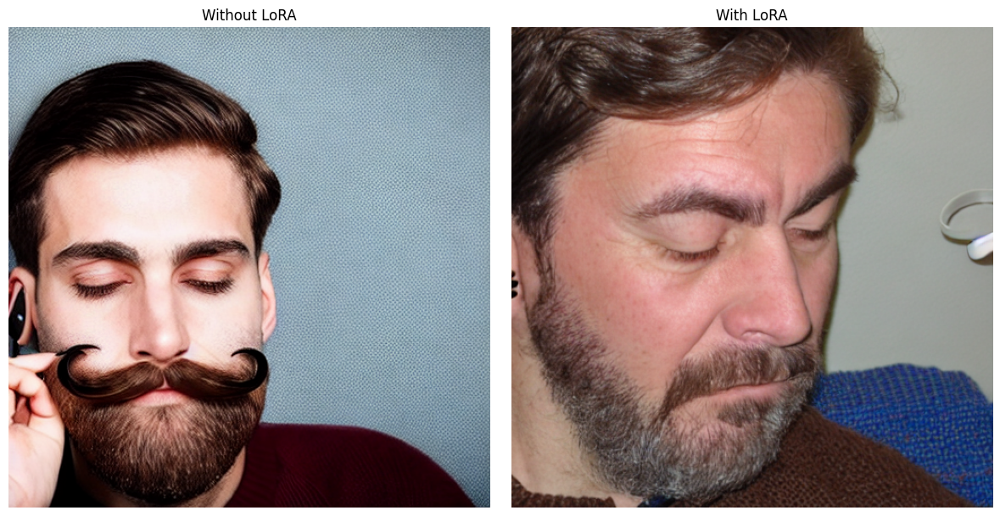

In [7]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a man with brown hair, a beard, and a mustache. He is wearing a brown sweater and appears to be in a relaxed state, possibly sleeping or resting. The man is wearing a blue pen in his ear, which might be an earbud or a hearing aid. The background of the image is blurry, which suggests that the focus is on the man and his facial expression."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

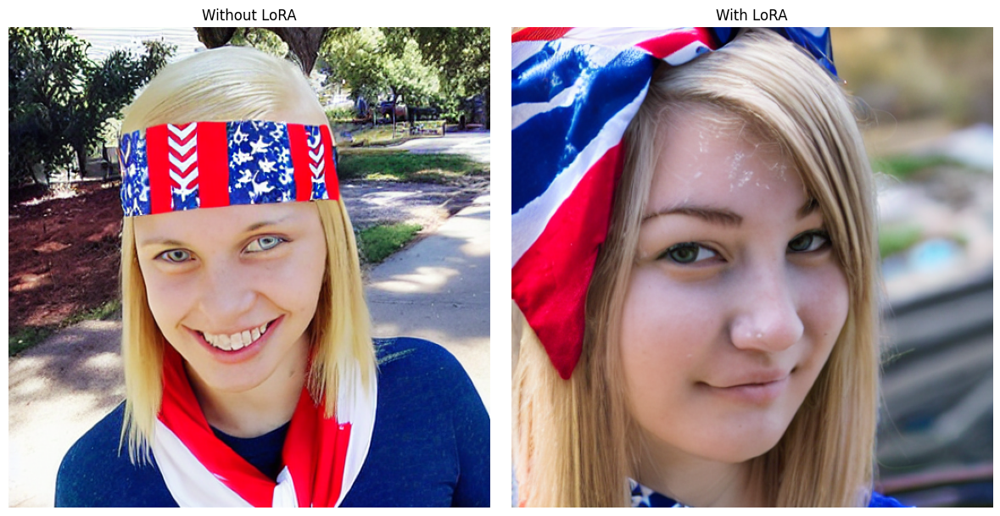

In [10]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "young woman with blonde hair, wearing a patriotic bandana on her head. She is looking at the camera with a smiling expression, indicating that she is happy or content. The woman's skin color is white, and she is in her late teens or early twenties."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=70, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=70, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

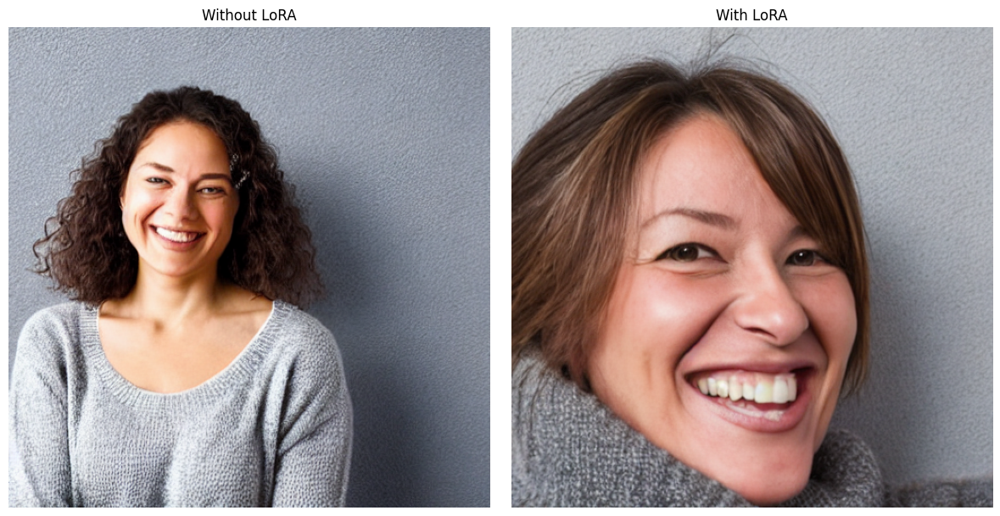

In [2]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a woman smiling and posing for a picture. She is wearing a gray sweater and appears to be happy and content. The background of the image is a white wall, which provides a clean and simple backdrop for the woman's portrait."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

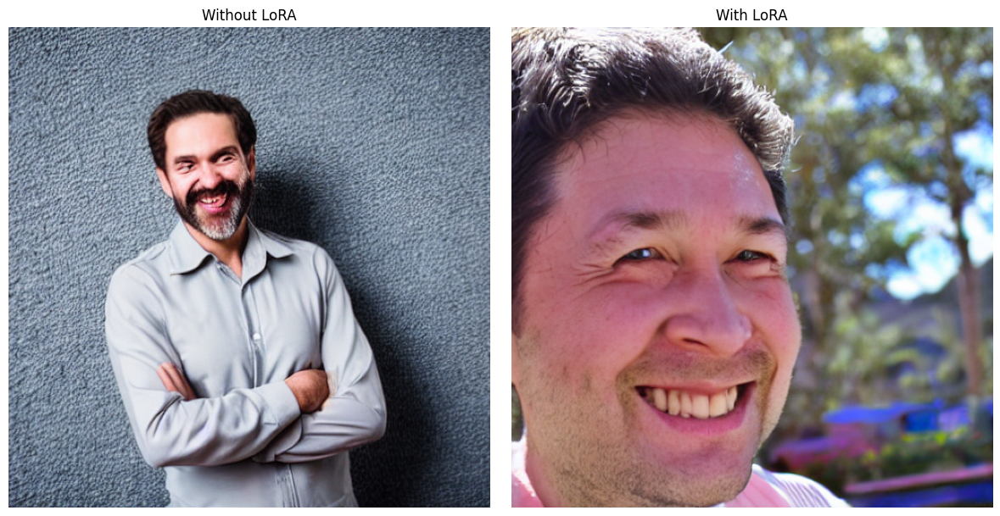

In [13]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a 30's man he is happy and looking to camera and background is blured ."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

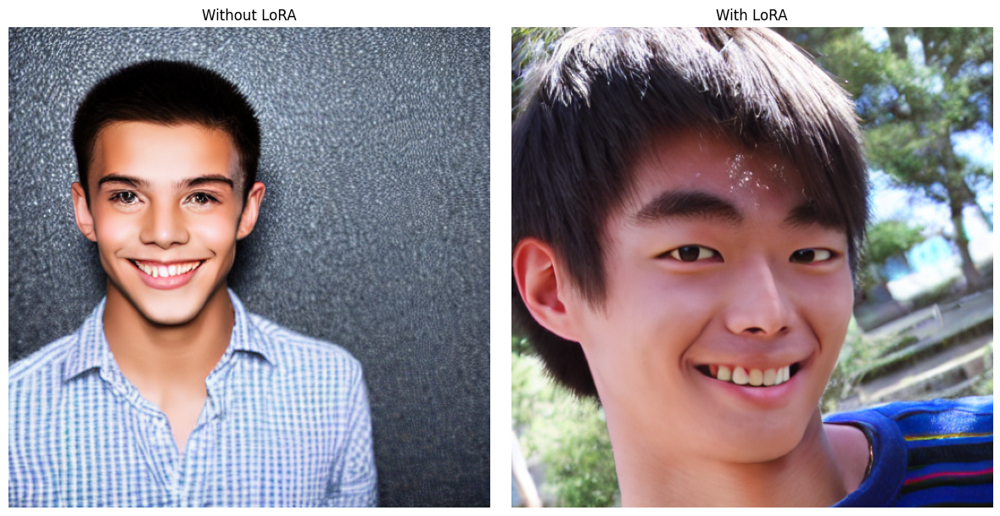

In [14]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young man he is happy and looking to camera and background is blured ."
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

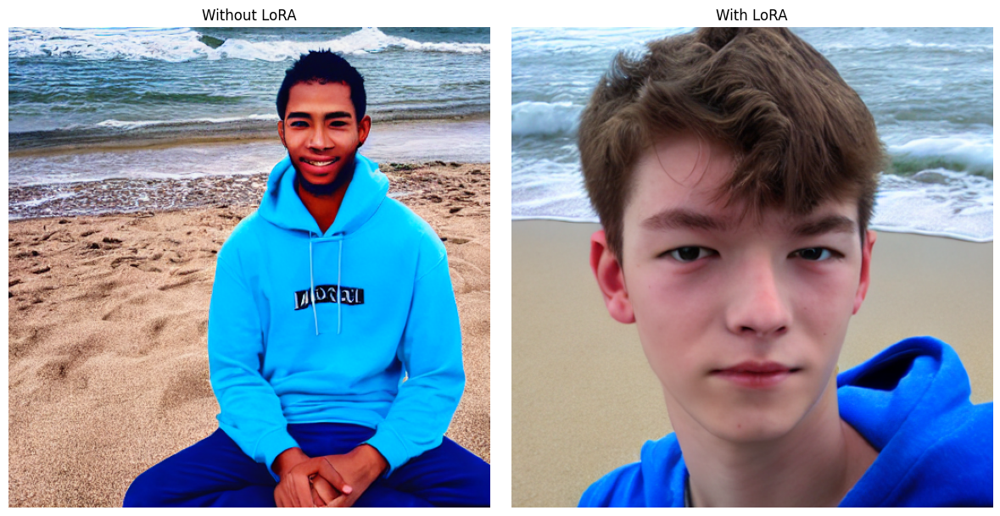

In [15]:
# Test difference
from diffusers import StableDiffusionPipeline
from peft import LoraConfig, get_peft_model
import torch
from PIL import Image
from torchvision.utils import save_image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    safety_checker=None,
    requires_safety_checker=False
).to(device)

prompt = "a young man wearing blue hoodie and sitting on the beach"
generator = torch.manual_seed(41)

image_base = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

lora_config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "to_q", "to_k", "to_v", "to_out.0",
        "proj_in", "proj_out",
        "conv1", "conv2", "conv_shortcut"
    ],
    lora_dropout=0.1,
    bias="none",
)
pipe.unet = get_peft_model(pipe.unet, lora_config)

lora_weights_path = "/kaggle/input/notebook2193d4de3c/epicphotogasm_lora/checkpoint_last_30.pth"
checkpoint = torch.load(lora_weights_path, map_location=device)
lora_state_dict = checkpoint["lora_weights"]
pipe.unet.load_state_dict(lora_state_dict, strict=False)

generator = torch.manual_seed(41)
image_lora = pipe(prompt, num_inference_steps=50, guidance_scale=9, generator=generator).images[0]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image_base)
axs[0].set_title("Without LoRA")
axs[0].axis("off")
axs[1].imshow(image_lora)
axs[1].set_title("With LoRA")
axs[1].axis("off")
plt.tight_layout()
plt.show()